In [4]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import warnings
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from sklearn.tree import DecisionTreeClassifier
from sklearn import tree
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.model_selection import cross_val_score
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
from sklearn.preprocessing import LabelEncoder
import joblib

In [5]:
import warnings
warnings.filterwarnings('ignore')

In [6]:
df=pd.read_csv("crop recommendation data.csv")

In [58]:
df.head()

,N,P,K,temperature,humidity,ph,rainfall,label
0,90,42,43,20.879744,82.002744,6.502985,202.935536,rice
1,85,58,41,21.770462,80.319644,7.038096,226.655537,rice
2,60,55,44,23.004459,82.320763,7.840207,263.964248,rice
3,74,35,40,26.491096,80.158363,6.980401,242.864034,rice
4,78,42,42,20.130175,81.604873,7.628473,262.717340,rice


In [8]:
df.tail()

,N,P,K,temperature,humidity,ph,rainfall,label
2195,107,34,32,26.774637,66.413269,6.780064,177.774507,coffee
2196,99,15,27,27.417112,56.636362,6.086922,127.924610,coffee
2197,118,33,30,24.131797,67.225123,6.362608,173.322839,coffee
2198,117,32,34,26.272418,52.127394,6.758793,127.175293,coffee
2199,104,18,30,23.603016,60.396475,6.779833,140.937041,coffee


In [9]:
df.shape

(2200, 8)

In [10]:
df.size

17600

In [11]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2200 entries, 0 to 2199
Data columns (total 8 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   N            2200 non-null   int64  
 1   P            2200 non-null   int64  
 2   K            2200 non-null   int64  
 3   temperature  2200 non-null   float64
 4   humidity     2200 non-null   float64
 5   ph           2200 non-null   float64
 6   rainfall     2200 non-null   float64
 7   label        2200 non-null   object 
dtypes: float64(4), int64(3), object(1)
memory usage: 137.6+ KB


In [12]:
df.dtypes

N                int64
P                int64
K                int64
temperature    float64
humidity       float64
ph             float64
rainfall       float64
label           object
dtype: object

In [13]:
df.isna().sum()

N              0
P              0
K              0
temperature    0
humidity       0
ph             0
rainfall       0
label          0
dtype: int64

In [14]:
df.columns

Index(['N', 'P', 'K', 'temperature', 'humidity', 'ph', 'rainfall', 'label'], dtype='object')

In [15]:
df.describe()

,N,P,K,temperature,humidity,ph,rainfall
count,2200.000000,2200.000000,2200.000000,2200.000000,2200.000000,2200.000000,2200.000000
mean,50.551818,53.362727,48.149091,25.616244,71.481779,6.469480,103.463655
std,36.917334,32.985883,50.647931,5.063749,22.263812,0.773938,54.958389
min,0.000000,5.000000,5.000000,8.825675,14.258040,3.504752,20.211267
25%,21.000000,28.000000,20.000000,22.769375,60.261953,5.971693,64.551686
50%,37.000000,51.000000,32.000000,25.598693,80.473146,6.425045,94.867624
75%,84.250000,68.000000,49.000000,28.561654,89.948771,6.923643,124.267508
max,140.000000,145.000000,205.000000,43.675493,99.981876,9.935091,298.560117


In [16]:
df["label"].unique()

array(['rice', 'maize', 'chickpea', 'kidneybeans', 'pigeonpeas',
       'mothbeans', 'mungbean', 'blackgram', 'lentil', 'pomegranate',
       'banana', 'mango', 'grapes', 'watermelon', 'muskmelon', 'apple',
       'orange', 'papaya', 'coconut', 'cotton', 'jute', 'coffee'],
      dtype=object)

In [17]:
print(df.corr())

                    N         P         K  temperature  humidity        ph  \
N            1.000000 -0.231460 -0.140512     0.026504  0.190688  0.096683   
P           -0.231460  1.000000  0.736232    -0.127541 -0.118734 -0.138019   
K           -0.140512  0.736232  1.000000    -0.160387  0.190859 -0.169503   
temperature  0.026504 -0.127541 -0.160387     1.000000  0.205320 -0.017795   
humidity     0.190688 -0.118734  0.190859     0.205320  1.000000 -0.008483   
ph           0.096683 -0.138019 -0.169503    -0.017795 -0.008483  1.000000   
rainfall     0.059020 -0.063839 -0.053461    -0.030084  0.094423 -0.109069   

             rainfall  
N            0.059020  
P           -0.063839  
K           -0.053461  
temperature -0.030084  
humidity     0.094423  
ph          -0.109069  
rainfall     1.000000  


In [18]:

plt.figure(figsize=(20,20))
px.imshow(df.corr(),text_auto=True)


<Figure size 2000x2000 with 0 Axes>

In [19]:
px.histogram(df,x="label",text_auto=True,pattern_shape="label",pattern_shape_sequence=[".","x","+"])

In [20]:
label_names=df["label"].unique()
for i in label_names:
    data=df[df["label"]==i]
    print(data.describe())
    print()
    print()
    print(i)
    print()

                N           P           K  temperature    humidity  \
count  100.000000  100.000000  100.000000   100.000000  100.000000   
mean    79.890000   47.580000   39.870000    23.689332   82.272822   
std     11.917981    7.904966    2.946167     2.031272    1.418381   
min     60.000000   35.000000   35.000000    20.045414   80.122675   
25%     69.000000   41.000000   38.000000    21.927064   80.952094   
50%     80.000000   47.000000   40.000000    23.734837   82.189357   
75%     91.000000   54.250000   42.000000    25.513702   83.470254   
max     99.000000   60.000000   45.000000    26.929951   84.969072   

               ph    rainfall  
count  100.000000  100.000000  
mean     6.425471  236.181114  
std      0.768692   34.291825  
min      5.005307  182.561632  
25%      5.869992  204.334023  
50%      6.363804  233.119859  
75%      7.039147  264.126903  
max      7.868475  298.560117  


rice

               N           P         K  temperature    humidity          

                N           P           K  temperature    humidity  \
count  100.000000  100.000000  100.000000   100.000000  100.000000   
mean   100.230000   82.010000   50.050000    27.376798   80.358123   
std     11.107241    7.690339    3.382591     1.428359    2.805481   
min     80.000000   70.000000   45.000000    25.010185   75.031933   
25%     92.000000   75.000000   47.000000    26.108408   78.062229   
50%    100.500000   81.000000   50.000000    27.443333   80.223599   
75%    108.250000   88.000000   53.000000    28.657735   82.960240   
max    120.000000   95.000000   55.000000    29.908885   84.978492   

               ph    rainfall  
count  100.000000  100.000000  
mean     5.983893  104.626980  
std      0.270650    9.398150  
min      5.505394   90.109781  
25%      5.740712   96.471109  
50%      5.994462  105.007750  
75%      6.211092  112.092171  
max      6.490074  119.847970  


banana

                N           P           K  temperature    humidity  \
c

                N           P           K  temperature    humidity  \
count  100.000000  100.000000  100.000000   100.000000  100.000000   
mean   101.200000   28.740000   29.940000    25.540477   58.869846   
std     12.345203    7.276113    3.246817     1.502635    5.838566   
min     80.000000   15.000000   25.000000    23.059519   50.045570   
25%     89.000000   23.000000   27.000000    24.218563   53.814433   
50%    103.000000   29.000000   30.000000    25.656643   57.648083   
75%    112.000000   34.250000   33.000000    26.744956   63.579586   
max    120.000000   40.000000   35.000000    27.923744   69.948073   

               ph    rainfall  
count  100.000000  100.000000  
mean     6.790308  158.066295  
std      0.417132   25.695086  
min      6.020947  115.156401  
25%      6.429728  136.011746  
50%      6.798626  157.770963  
75%      7.132105  181.472018  
max      7.493192  199.473564  


coffee



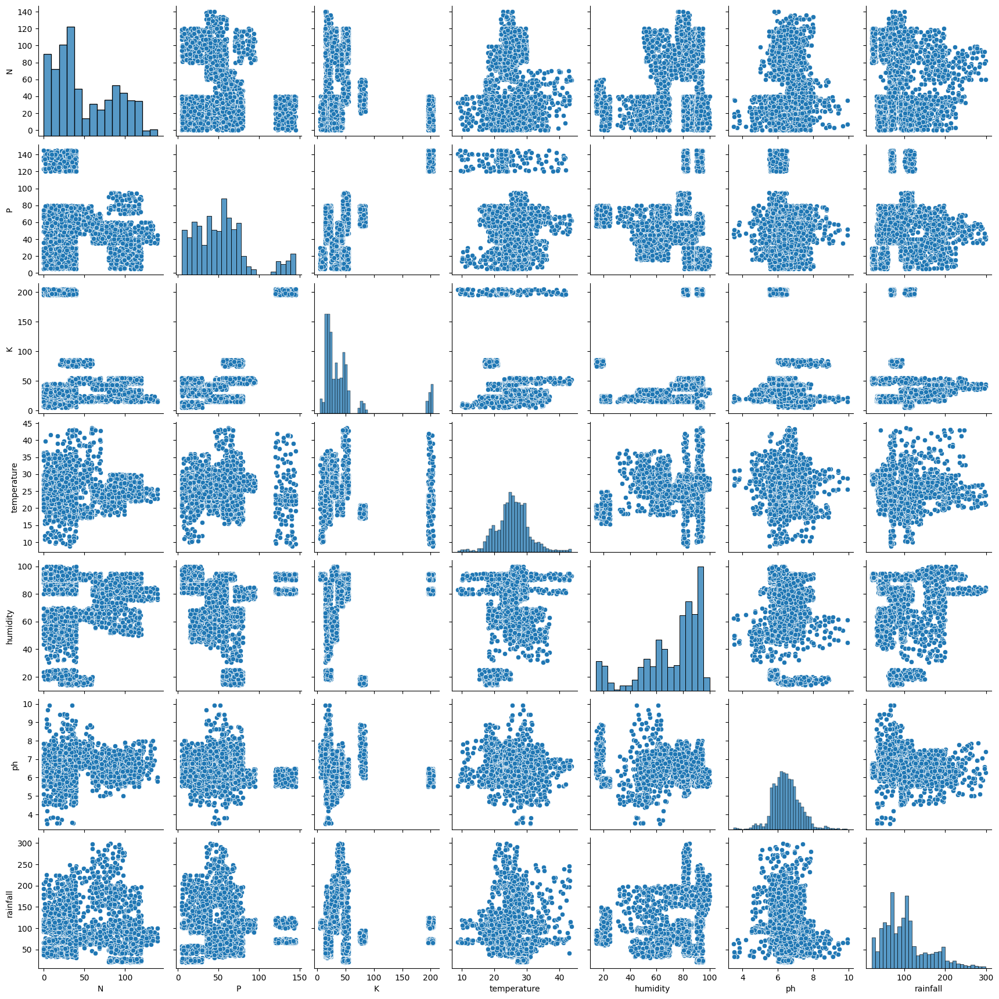

In [21]:
sns.pairplot(df)

In [22]:
crops_mean=[]
label_names=df["label"].unique()
for i in label_names:
    data=df[df["label"]==i]
    crops_mean.append(data.mean())
    

In [23]:
len(label_names)

22

<AxesSubplot:xlabel='rainfall', ylabel='Density'>

<Figure size 3000x3000 with 0 Axes>

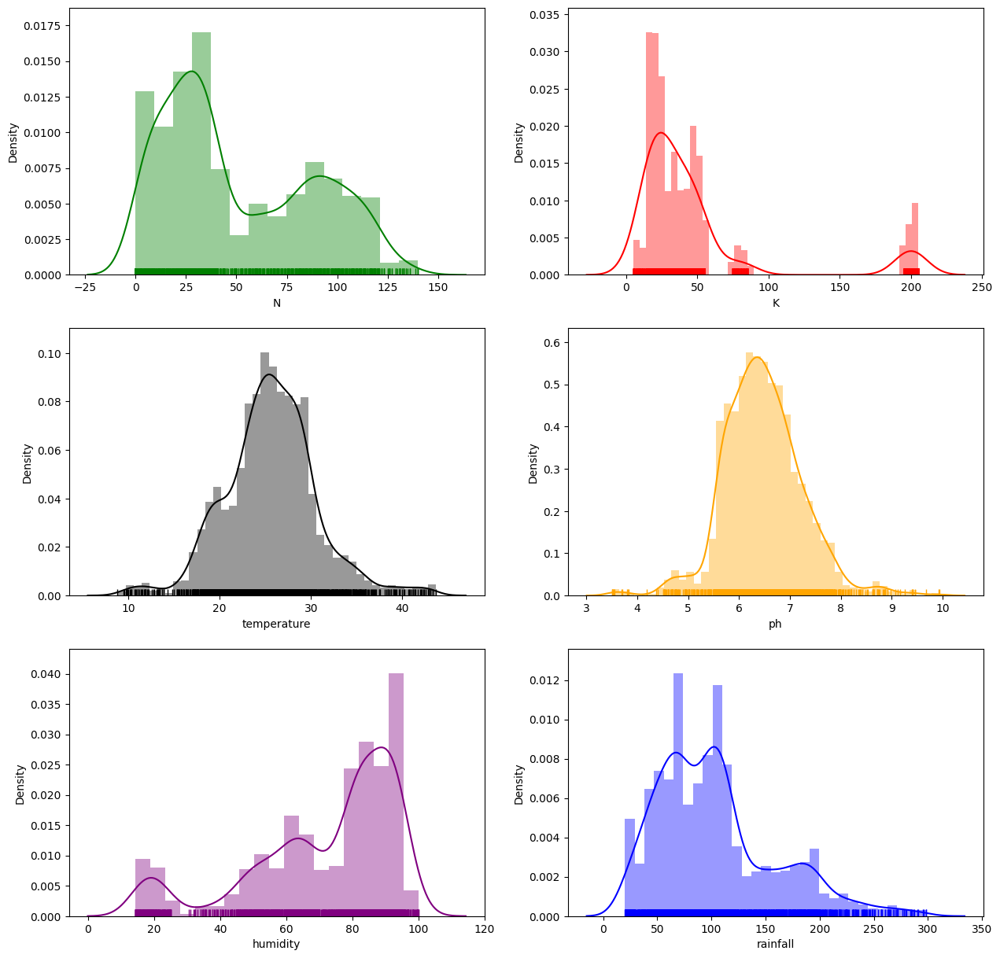

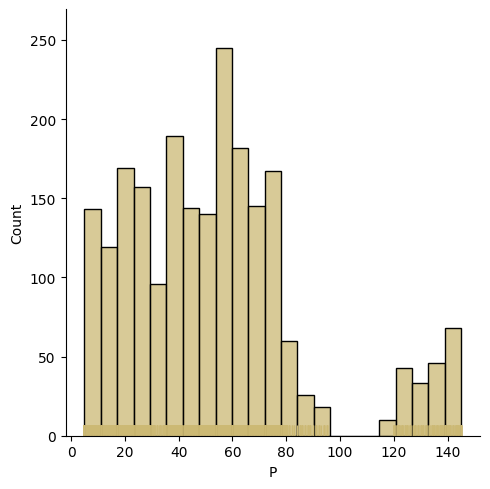

In [24]:
sns.set_color_codes()
plt.figure(figsize=(30,30))
fig,axs=plt.subplots(3,2,figsize=(15,15))
sns.distplot(df["N"],color="green",rug=True,ax=axs[0,0])
sns.displot(df["P"],color="y",rug=True,ax=axs[1,0])
sns.distplot(df["K"],color="red",rug=True,ax=axs[0,1])
sns.distplot(df["temperature"],color="black",rug=True,ax=axs[1,0])
sns.distplot(df["ph"],color="orange",rug=True,ax=axs[1,1])
sns.distplot(df["humidity"],color="purple",rug=True,ax=axs[2,0])
sns.distplot(df["rainfall"],color="blue",rug=True,ax=axs[2,1])

<AxesSubplot:xlabel='rainfall'>

<Figure size 3000x3000 with 0 Axes>

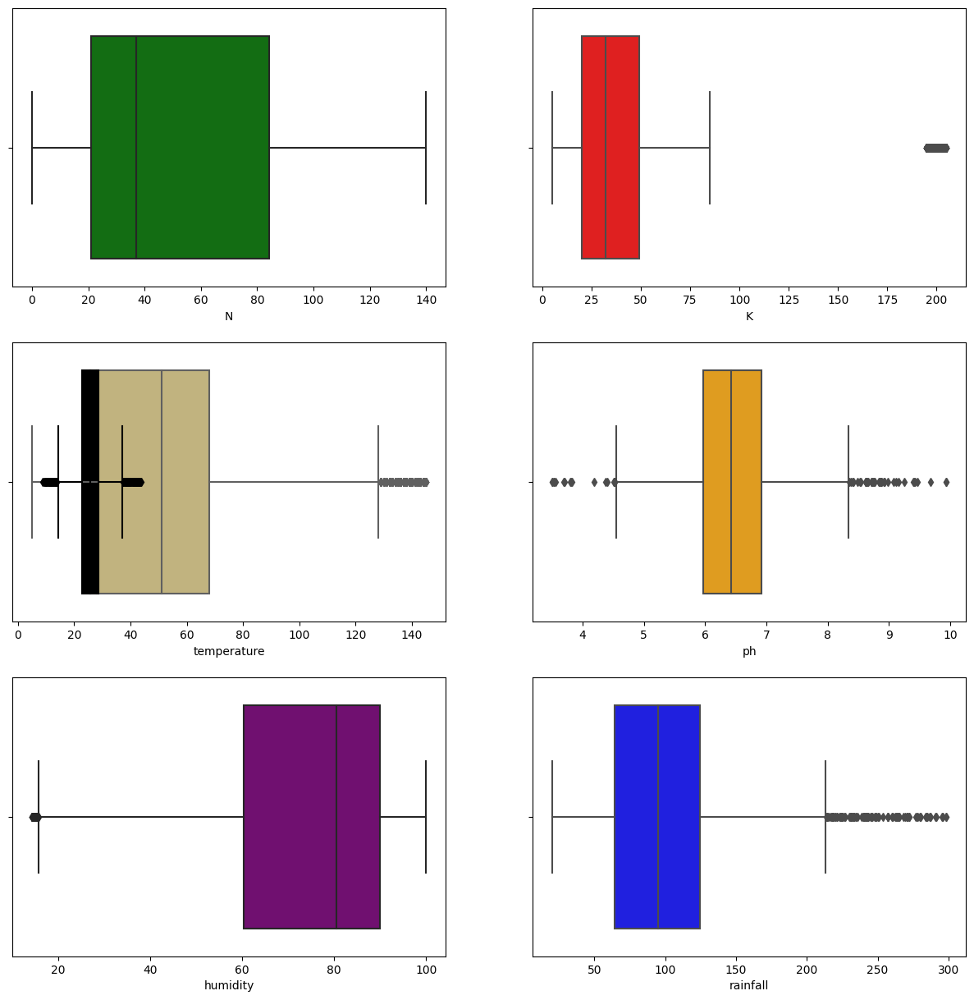

In [25]:
sns.set_color_codes()
plt.figure(figsize=(30,30))
fig,axs=plt.subplots(3,2,figsize=(15,15))
sns.boxplot(df["N"],color="green",ax=axs[0,0],saturation=0.7)
sns.boxplot(df["P"],color="y",ax=axs[1,0])
sns.boxplot(df["K"],color="red",ax=axs[0,1])
sns.boxplot(df["temperature"],color="black",ax=axs[1,0])
sns.boxplot(df["ph"],color="orange",ax=axs[1,1])
sns.boxplot(df["humidity"],color="purple",ax=axs[2,0])
sns.boxplot(df["rainfall"],color="blue",ax=axs[2,1])


In [26]:
df.head()

,N,P,K,temperature,humidity,ph,rainfall,label
0,90,42,43,20.879744,82.002744,6.502985,202.935536,rice
1,85,58,41,21.770462,80.319644,7.038096,226.655537,rice
2,60,55,44,23.004459,82.320763,7.840207,263.964248,rice
3,74,35,40,26.491096,80.158363,6.980401,242.864034,rice
4,78,42,42,20.130175,81.604873,7.628473,262.717340,rice


In [27]:
data=df.sample(frac=1).reset_index(drop=True)

In [28]:
data.head()

,N,P,K,temperature,humidity,ph,rainfall,label
0,83,29,52,25.764027,87.593113,6.704689,46.051227,watermelon
1,66,58,35,23.564383,79.462831,7.321619,185.259470,jute
2,94,5,55,28.585465,91.892168,6.085682,26.883726,muskmelon
3,25,27,41,19.200904,94.276596,6.923509,108.042355,pomegranate
4,112,28,54,24.860946,85.053186,6.738031,55.295635,watermelon


In [29]:
x=df.drop("label",axis=1)
y=df["label"]

In [30]:
 x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.3)

In [31]:
print(x_train.shape)
print(x_test.shape)
print(y_train.shape)
print(y_test.shape)

(1540, 7)
(660, 7)
(1540,)
(660,)


In [32]:
logis=LogisticRegression()
logis.fit(x_train,y_train)


LogisticRegression()

In [33]:
pred=logis.predict(x_test)

In [34]:
pred[0:10]

array(['orange', 'coconut', 'maize', 'watermelon', 'coconut', 'orange',
       'banana', 'cotton', 'pomegranate', 'mango'], dtype=object)

In [35]:
accuracy_score(y_test,pred)

0.956060606060606

In [36]:
print(classification_report(y_test,pred))

              precision    recall  f1-score   support

       apple       1.00      1.00      1.00        32
      banana       1.00      1.00      1.00        27
   blackgram       0.79      0.90      0.84        29
    chickpea       1.00      1.00      1.00        27
     coconut       1.00      0.97      0.99        34
      coffee       0.97      1.00      0.99        33
      cotton       0.88      0.97      0.92        29
      grapes       1.00      1.00      1.00        29
        jute       0.85      0.91      0.88        32
 kidneybeans       0.96      1.00      0.98        27
      lentil       0.97      0.85      0.90        39
       maize       0.96      0.82      0.88        28
       mango       1.00      1.00      1.00        34
   mothbeans       0.84      0.87      0.85        30
    mungbean       0.97      1.00      0.98        31
   muskmelon       1.00      1.00      1.00        30
      orange       1.00      1.00      1.00        35
      papaya       1.00    

In [37]:
desion=DecisionTreeClassifier()
desion.fit(x_train,y_train)

DecisionTreeClassifier()

In [38]:
p=desion.predict(x_test)

In [39]:
accuracy_score(y_test,p)

0.9863636363636363

In [40]:
print(classification_report(y_test,p))

              precision    recall  f1-score   support

       apple       1.00      1.00      1.00        32
      banana       1.00      1.00      1.00        27
   blackgram       1.00      1.00      1.00        29
    chickpea       1.00      1.00      1.00        27
     coconut       1.00      1.00      1.00        34
      coffee       1.00      1.00      1.00        33
      cotton       1.00      1.00      1.00        29
      grapes       1.00      1.00      1.00        29
        jute       0.88      0.91      0.89        32
 kidneybeans       1.00      1.00      1.00        27
      lentil       1.00      0.95      0.97        39
       maize       1.00      1.00      1.00        28
       mango       1.00      1.00      1.00        34
   mothbeans       0.94      1.00      0.97        30
    mungbean       1.00      1.00      1.00        31
   muskmelon       1.00      1.00      1.00        30
      orange       1.00      1.00      1.00        35
      papaya       1.00    

In [41]:
y_train

2198         coffee
699        mungbean
1640         orange
756       blackgram
346     kidneybeans
           ...     
984     pomegranate
532       mothbeans
118           maize
1560          apple
1009         banana
Name: label, Length: 1540, dtype: object

In [42]:
x_train.columns

Index(['N', 'P', 'K', 'temperature', 'humidity', 'ph', 'rainfall'], dtype='object')

In [43]:
plt.figure(figsize=(350,350))
plt.show(tree.plot_tree(desion,filled=True,fontsize=100,feature_names=x_train.columns))

In [44]:
model=RandomForestClassifier()
model.fit(x_train,y_train)

RandomForestClassifier()

In [45]:
pred1=model.predict(x_test)

In [46]:
pred1

array(['orange', 'coconut', 'maize', 'watermelon', 'coconut', 'orange',
       'banana', 'cotton', 'pomegranate', 'mango', 'mango', 'coconut',
       'cotton', 'kidneybeans', 'blackgram', 'cotton', 'blackgram',
       'kidneybeans', 'watermelon', 'maize', 'grapes', 'blackgram',
       'chickpea', 'grapes', 'grapes', 'jute', 'papaya', 'grapes',
       'watermelon', 'lentil', 'coconut', 'coconut', 'grapes',
       'blackgram', 'mungbean', 'mango', 'kidneybeans', 'coconut', 'jute',
       'mango', 'banana', 'maize', 'cotton', 'orange', 'coffee', 'banana',
       'apple', 'rice', 'maize', 'rice', 'lentil', 'apple', 'pomegranate',
       'mothbeans', 'blackgram', 'coffee', 'pigeonpeas', 'mungbean',
       'mango', 'rice', 'pomegranate', 'grapes', 'mothbeans', 'jute',
       'lentil', 'watermelon', 'coffee', 'lentil', 'kidneybeans', 'apple',
       'lentil', 'jute', 'grapes', 'banana', 'chickpea', 'cotton', 'rice',
       'kidneybeans', 'lentil', 'lentil', 'coconut', 'banana', 'papaya',
    

In [47]:
accuracy_score(y_test,pred1)

0.9939393939393939

In [48]:
print(classification_report(y_test,pred1))

              precision    recall  f1-score   support

       apple       1.00      1.00      1.00        32
      banana       1.00      1.00      1.00        27
   blackgram       1.00      1.00      1.00        29
    chickpea       1.00      1.00      1.00        27
     coconut       1.00      1.00      1.00        34
      coffee       1.00      1.00      1.00        33
      cotton       1.00      1.00      1.00        29
      grapes       1.00      1.00      1.00        29
        jute       0.94      1.00      0.97        32
 kidneybeans       1.00      1.00      1.00        27
      lentil       1.00      0.95      0.97        39
       maize       1.00      1.00      1.00        28
       mango       1.00      1.00      1.00        34
   mothbeans       0.94      1.00      0.97        30
    mungbean       1.00      1.00      1.00        31
   muskmelon       1.00      1.00      1.00        30
      orange       1.00      1.00      1.00        35
      papaya       1.00    

In [49]:
svm=SVC()

In [50]:
svm.fit(x_train,y_train)

SVC()

In [51]:
prediction=svm.predict(x_test)

In [52]:
prediction

array(['orange', 'coconut', 'maize', 'watermelon', 'coconut', 'orange',
       'banana', 'cotton', 'pomegranate', 'mango', 'mango', 'coconut',
       'cotton', 'kidneybeans', 'blackgram', 'cotton', 'blackgram',
       'kidneybeans', 'watermelon', 'maize', 'grapes', 'blackgram',
       'chickpea', 'grapes', 'grapes', 'jute', 'papaya', 'grapes',
       'watermelon', 'lentil', 'coconut', 'coconut', 'grapes',
       'blackgram', 'mungbean', 'mango', 'kidneybeans', 'coconut', 'jute',
       'mango', 'banana', 'maize', 'cotton', 'orange', 'jute', 'banana',
       'apple', 'rice', 'maize', 'rice', 'lentil', 'apple', 'pomegranate',
       'blackgram', 'blackgram', 'coffee', 'pigeonpeas', 'mungbean',
       'mango', 'rice', 'pomegranate', 'grapes', 'mothbeans', 'jute',
       'lentil', 'watermelon', 'coffee', 'lentil', 'kidneybeans', 'apple',
       'lentil', 'jute', 'grapes', 'banana', 'chickpea', 'cotton', 'rice',
       'kidneybeans', 'lentil', 'lentil', 'coconut', 'banana', 'papaya',
      

In [53]:
accuracy_score(y_test,prediction)

0.9757575757575757

In [54]:
print(classification_report(y_test,prediction))

              precision    recall  f1-score   support

       apple       1.00      1.00      1.00        32
      banana       1.00      1.00      1.00        27
   blackgram       0.91      1.00      0.95        29
    chickpea       1.00      1.00      1.00        27
     coconut       1.00      1.00      1.00        34
      coffee       1.00      0.97      0.98        33
      cotton       0.94      1.00      0.97        29
      grapes       1.00      1.00      1.00        29
        jute       0.80      1.00      0.89        32
 kidneybeans       0.93      1.00      0.96        27
      lentil       1.00      0.95      0.97        39
       maize       1.00      0.93      0.96        28
       mango       1.00      1.00      1.00        34
   mothbeans       0.97      0.97      0.97        30
    mungbean       1.00      1.00      1.00        31
   muskmelon       1.00      1.00      1.00        30
      orange       1.00      1.00      1.00        35
      papaya       1.00    